In [1]:
from pycocotools.coco import COCO
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import skimage.io as io
import pylab
import os

In [2]:
classes = ("General trash", "Paper", "Paper pack", "Metal", "Glass", 
           "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing")
colors = ['C0','C1','C2','C3','C4','C5','C6','C7','C8','C9']

root='../dataset/'

ann_file = root + 'train.json'

coco=COCO(ann_file)

loading annotations into memory...
Done (t=0.08s)
creating index...
index created!


In [3]:
cats = coco.loadCats(coco.getCatIds())
nms=[cat['name'] for cat in cats]
print('COCO categories: \n{}\n'.format(' '.join(nms)))

COCO categories: 
General trash Paper Paper pack Metal Glass Plastic Styrofoam Plastic bag Battery Clothing



In [4]:
catIds = [coco.getCatIds(catNms=[cat['name']]) for cat in cats]
imgIds = [coco.getImgIds(catIds=catId) for catId in catIds]

imgs = [coco.loadImgs(imgId[0])[0] for imgId in imgIds]
print(imgs)

[{'width': 1024, 'height': 1024, 'file_name': 'train/0000.jpg', 'license': 0, 'flickr_url': None, 'coco_url': None, 'date_captured': '2020-12-26 14:44:23', 'id': 0}, {'width': 1024, 'height': 1024, 'file_name': 'train/0004.jpg', 'license': 0, 'flickr_url': None, 'coco_url': None, 'date_captured': '2021-01-01 18:52:38', 'id': 4}, {'width': 1024, 'height': 1024, 'file_name': 'train/0003.jpg', 'license': 0, 'flickr_url': None, 'coco_url': None, 'date_captured': '2021-03-31 12:10:36', 'id': 3}, {'width': 1024, 'height': 1024, 'file_name': 'train/0001.jpg', 'license': 0, 'flickr_url': None, 'coco_url': None, 'date_captured': '2021-01-10 16:30:39', 'id': 1}, {'width': 1024, 'height': 1024, 'file_name': 'train/0001.jpg', 'license': 0, 'flickr_url': None, 'coco_url': None, 'date_captured': '2021-01-10 16:30:39', 'id': 1}, {'width': 1024, 'height': 1024, 'file_name': 'train/0001.jpg', 'license': 0, 'flickr_url': None, 'coco_url': None, 'date_captured': '2021-01-10 16:30:39', 'id': 1}, {'width':

In [ ]:
for index in range(10): #category bounding box check
    img = cv2.imread(os.path.join(root ,imgs[index]['file_name']))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32)
    img /= 255.0
    plot = plt.subplot(2, 5, index + 1)
    
    annIds = coco.getAnnIds(imgIds=imgs[index]['id'], catIds=index, iscrowd=None)
    anns = coco.loadAnns(annIds)
    for ann in anns:
        box = ann['bbox']
        bb = patches.Rectangle((box[0],box[1]), box[2],box[3], linewidth=1, edgecolor="C2", facecolor="none")
        plot.add_patch(bb)
    
    plt.imshow(img), plt.axis('off')
    plt.title(nms[index])

plt.subplots_adjust(left=0.125,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.5, 
                    wspace=0.2, 
                    hspace=0.35)
plt.show()

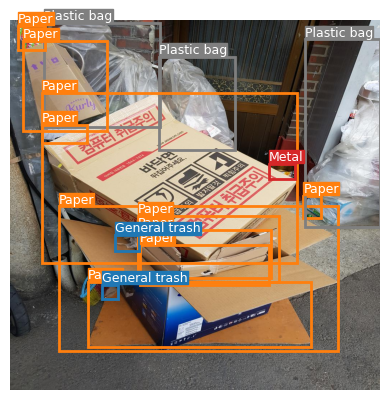

In [13]:
# index 바꿔가면서 사진 확인
index=1357    # 0 ~ 4882

# 이미지 아이디 가져오기
image_id = coco.getImgIds(imgIds=index)

# 이미지 정보 가져오기
image_info = coco.loadImgs(image_id)[0]

# 이미지 로드
image = cv2.imread(os.path.join(root, image_info['file_name']))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
image /= 255.0

# 어노테이션 파일 로드
ann_ids = coco.getAnnIds(imgIds=image_info['id'])
anns = coco.loadAnns(ann_ids)

# 박스 가져오기
boxes = np.array([x['bbox'] for x in anns])

# boxes (x_min, y_min, x_max, y_max) 꼴로 변환
boxes[:, 2] = boxes[:, 0] + boxes[:, 2]
boxes[:, 3] = boxes[:, 1] + boxes[:, 3]

# 레이블 가져오기
labels = np.array([x['category_id'] for x in anns])


# 시각화 해보기
fig, ax = plt.subplots()
plt.axis('off')
ax.imshow(image)
for box, label in zip(boxes, labels):
   x = box[0]
   y = box[1]
   width = box[2] - x
   height = box[3] - y
   ax.add_patch(
      patches.Rectangle(
         (x, y),                   # (x, y)
         width, height,            # width, height
         edgecolor = colors[label],
         linewidth=2,
         fill=False,
      ))
   label_class = classes[label]
   ax.text(x=x, y=y-10, fontsize=9,s=label_class, color='white', bbox=dict(facecolor=colors[label], ec=colors[label], alpha=1, pad=0))
plt.show()